In [18]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

In [19]:
streamlines = np.load('streamlines.npz')
def get_streamline(i):
    return streamlines[f'arr_{i}']

In [20]:
len(streamlines)

148659

In [21]:
streamlines

NpzFile 'streamlines.npz' with keys: arr_0, arr_1, arr_2, arr_3, arr_4...

In [23]:
rng = np.random.default_rng(0)
idxs = rng.choice(len(streamlines), size=2000, replace=False)
streamline_lengths = [len(get_streamline(idx)) for idx in idxs]
print('mean:', np.mean(streamline_lengths))
print('std:', np.std(streamline_lengths))
print('min:', np.min(streamline_lengths))
print('max:', np.max(streamline_lengths))

mean: 39.579
std: 38.70251618435163
min: 3
max: 258


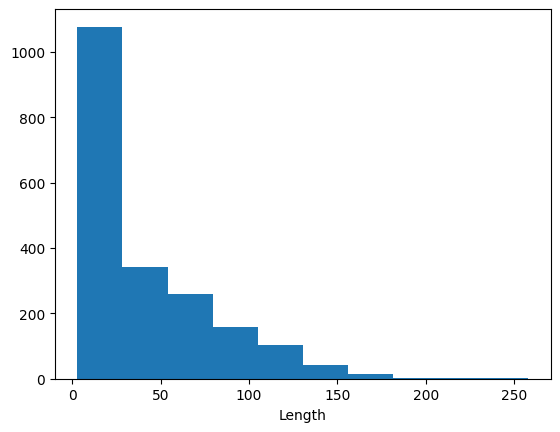

In [24]:
plt.hist(streamline_lengths)
plt.xlabel('Length')
plt.show()

In [25]:
def calculate_streamline_length(streamline):
    return np.sum(np.sqrt(np.sum(np.diff(streamline, axis=0) ** 2, axis=1)))

streamline_lengths_mm = [calculate_streamline_length(get_streamline(idx)) for idx in idxs]
print('mean:', np.mean(streamline_lengths_mm))
print('std:', np.std(streamline_lengths_mm))
print('min:', np.min(streamline_lengths_mm))
print('max:', np.max(streamline_lengths_mm))

mean: 19.2895
std: 19.351258092175815
min: 0.9999999999999903
max: 128.5


In [26]:
np.quantile(streamline_lengths_mm, [0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

array([ 1.   ,  1.   ,  1.5  ,  4.   , 12.25 , 30.   , 49.5  , 58.5  ,
       74.515])

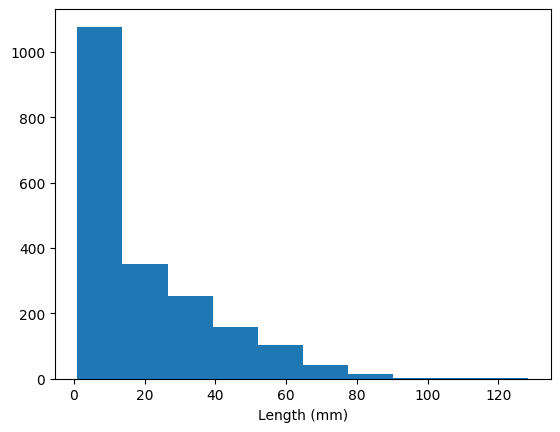

In [28]:
plt.hist(streamline_lengths_mm)
plt.xlabel('Length (mm)')
plt.show()

# Interpolate streamlines

In [30]:
def interpolate_streamline(streamline, n):
    cumulative_lengths = np.cumsum(np.sqrt(np.sum(np.diff(streamline, axis=0) ** 2, axis=1)))
    cumulative_lengths = np.insert(cumulative_lengths, 0, 0)
    t = np.linspace(0, cumulative_lengths[-1], n)
    x = np.interp(t, cumulative_lengths, streamline[:, 0])
    y = np.interp(t, cumulative_lengths, streamline[:, 1])
    z = np.interp(t, cumulative_lengths, streamline[:, 2])
    return np.stack([x, y, z], axis=1)

streamlines_interpolated = np.array([interpolate_streamline(get_streamline(idx), 256) for idx in idxs])

In [31]:
streamlines_interpolated.shape

(2000, 256, 3)

In [32]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure()

rng = np.random.default_rng(0)

for i in range(len(streamlines_interpolated)):
    st = streamlines_interpolated[i]

    n = st.shape[0]
    x = st[:, 0]
    y = st[:, 1]
    z = st[:, 2]
    color = rng.uniform(0, 1, 3)

    # Draw a 3D line connecting the points
    fig.add_trace(go.Scatter3d(x=x, y=y, z=z, mode='lines', line=dict(color=f'rgb({color[0]*255},{color[1]*255},{color[2]*255})', width=2), opacity=0.6))

fig.update_layout(scene=dict(
                    xaxis_title='X Label',
                    yaxis_title='Y Label',
                    zaxis_title='Z Label'),
                  width=800,
                  margin=dict(r=20, b=10, l=10, t=10))

fig.show()

# Visualize

In [20]:
centroid_atlas = [-2.8441544, -21.624807, 5.540867] # default to atlas brain centroid
rad_atlas = 100 # preset radius

In [21]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure()

rng = np.random.default_rng(0)

for i in range(500):
    st = streamlines[f'arr_{rng.integers(0, len(streamlines))}']

    n = st.shape[0]
    x = st[:, 0]
    y = st[:, 1]
    z = st[:, 2]
    color = rng.uniform(0, 1, 3)

    # Draw a 3D line connecting the points
    fig.add_trace(go.Scatter3d(x=x, y=y, z=z, mode='lines', line=dict(color=f'rgb({color[0]*255},{color[1]*255},{color[2]*255})', width=2), opacity=0.6))

# Draw a sphere with radius 60
radius = rad_atlas
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)
x_sphere = -centroid_atlas[0] + radius * np.outer(np.cos(u), np.sin(v))
y_sphere = -centroid_atlas[1] + radius * np.outer(np.sin(u), np.sin(v))
z_sphere = -centroid_atlas[2] + radius * np.outer(np.ones(np.size(u)), np.cos(v))

# fig.add_trace(go.Surface(x=x_sphere, y=y_sphere, z=z_sphere, colorscale='Reds', opacity=0.3))

fig.update_layout(scene=dict(
                    xaxis_title='X Label',
                    yaxis_title='Y Label',
                    zaxis_title='Z Label'),
                  width=800,
                  margin=dict(r=20, b=10, l=10, t=10))

fig.show()